<a href="https://colab.research.google.com/github/plaban1981/Stable_Diffusion_codes/blob/main/Fast_Image_Geneartion_using_LCM_LORA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## LCM-LORA (Latent Consistency Model): Universal Stable Diffusion Acceleration Module

* It accelerates image generation task
* Traditional methods require a lengthy 25 to 50 steps for image generation.
* But with LCM Lora we require just 4 to 8 steps there by making the process faster , more efficient without compromising on the quality.


* LCM distills the original model into a separate model
* Stable Diffusin HD XL they used to take 25 to 50 steps
* run 7 to 8X faster
* LoRA- to learn only small number of adapter layers instaed of the complete layer
* Steps
    - Select a teacher model from the HF_Hub
    - Select Finetuned DreamBooth model or Stable Diffusion models
    - Learn LCM LORA on the model
    - Use LORA with any SDXL and LCM scheduler
* It can be esily used with diffusers library. We use it for inferencing

## Install required Dependencies

In [1]:
%%capture
!pip install --upgrade diffusers[torch]

In [2]:
import torch
from diffusers import DiffusionPipeline,LCMScheduler

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

##Load Model

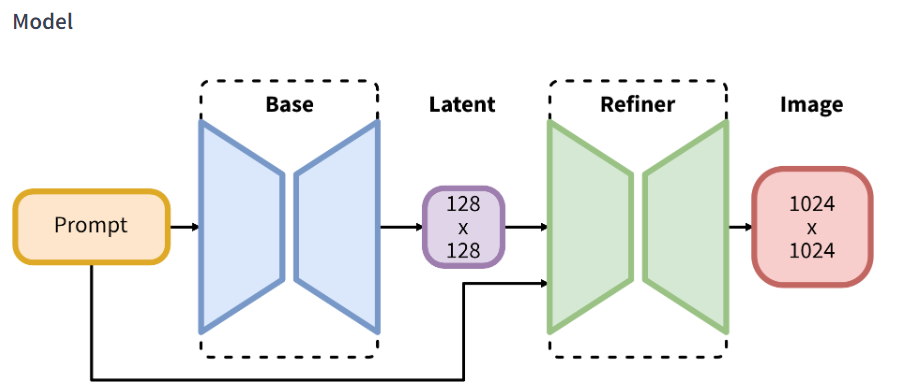


SDXL consists of an ensemble of experts pipeline for latent diffusion: In a first step, the base model is used to generate (noisy) latents, which are then further processed with a refinement model (available here: https://huggingface.co/stabilityai/stable-diffusion-xl-refiner-1.0/) specialized for the final denoising steps. Note that the base model can be used as a standalone module.

Alternatively, we can use a two-stage pipeline as follows: First, the base model is used to generate latents of the desired output size. In the second step, we use a specialized high-resolution model and apply a technique called SDEdit (https://arxiv.org/abs/2108.01073, also known as "img2img") to the latents generated in the first step, using the same prompt. This technique is slightly slower than the first one, as it requires more function evaluations.

In [55]:
model_id = "stabilityai/stable-diffusion-xl-base-1.0"
lcm_lora_id = "latent-consistency/lcm-lora-sdxl"
#
pipe = DiffusionPipeline.from_pretrained(model_id,variant = "fp16")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

## Load the Lora Weights

* 394 Million safe_tensors parameters

In [56]:
pipe.load_lora_weights(lcm_lora_id)

## LCM Scheduler

In [57]:
pipe.scheduler = LCMScheduler.from_config(pipe.scheduler.config)

The config attributes {'skip_prk_steps': True} were passed to LCMScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.


## Pipe to Cuda

In [58]:
pipe.to(device="cuda",dtype=torch.float16)

StableDiffusionXLPipeline {
  "_class_name": "StableDiffusionXLPipeline",
  "_diffusers_version": "0.23.1",
  "_name_or_path": "stabilityai/stable-diffusion-xl-base-1.0",
  "force_zeros_for_empty_prompt": true,
  "scheduler": [
    "diffusers",
    "LCMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

## Define a prompt

In [10]:
prompt = "a photorealistic fashion photography of an Indian Fashon Model standing under a lamp post in a street with rain falling in the background"

## Generate Image

In [8]:
images = pipe(prompt=prompt,
              num_inference_steps = 5,
              guidance_scale = 1).images[0]

  0%|          | 0/5 [00:00<?, ?it/s]

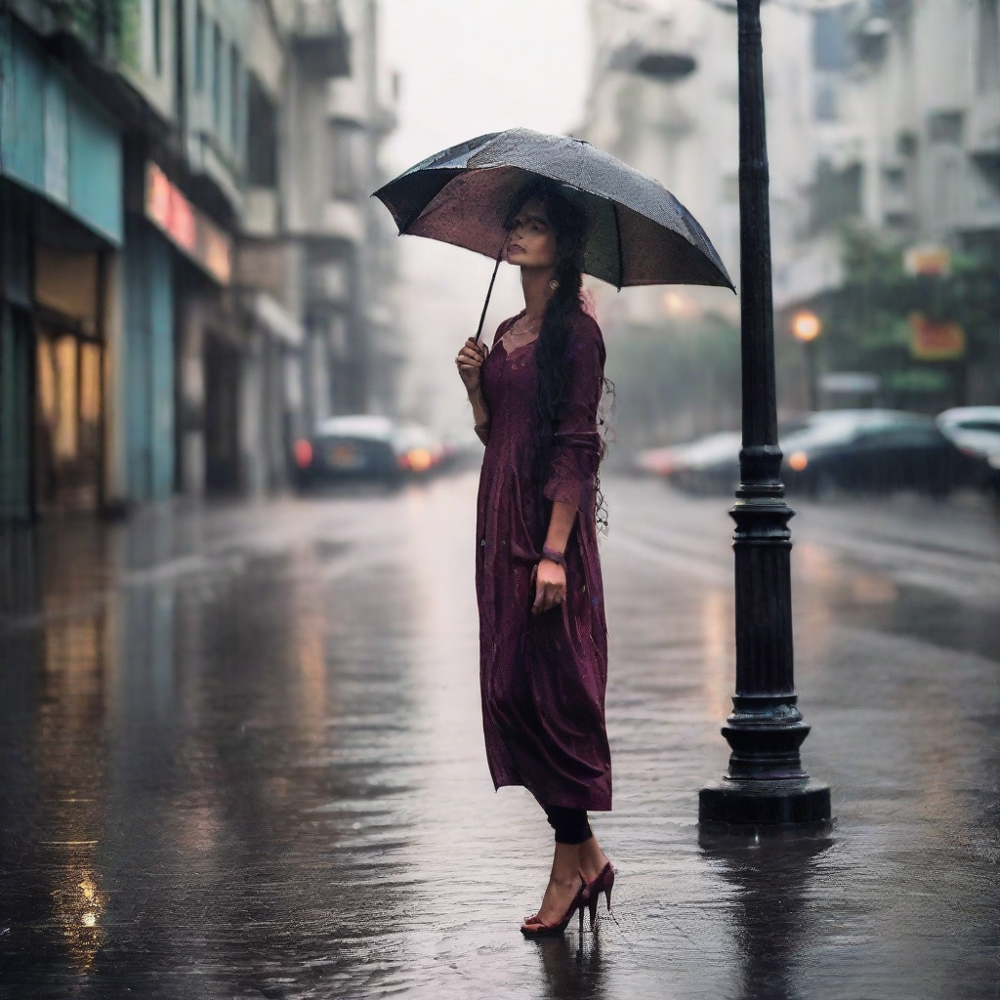

In [9]:
images

In [16]:
images = pipe(prompt=prompt,
              num_inference_steps = 5,
              guidance_scale = 1.5).images

  0%|          | 0/5 [00:00<?, ?it/s]

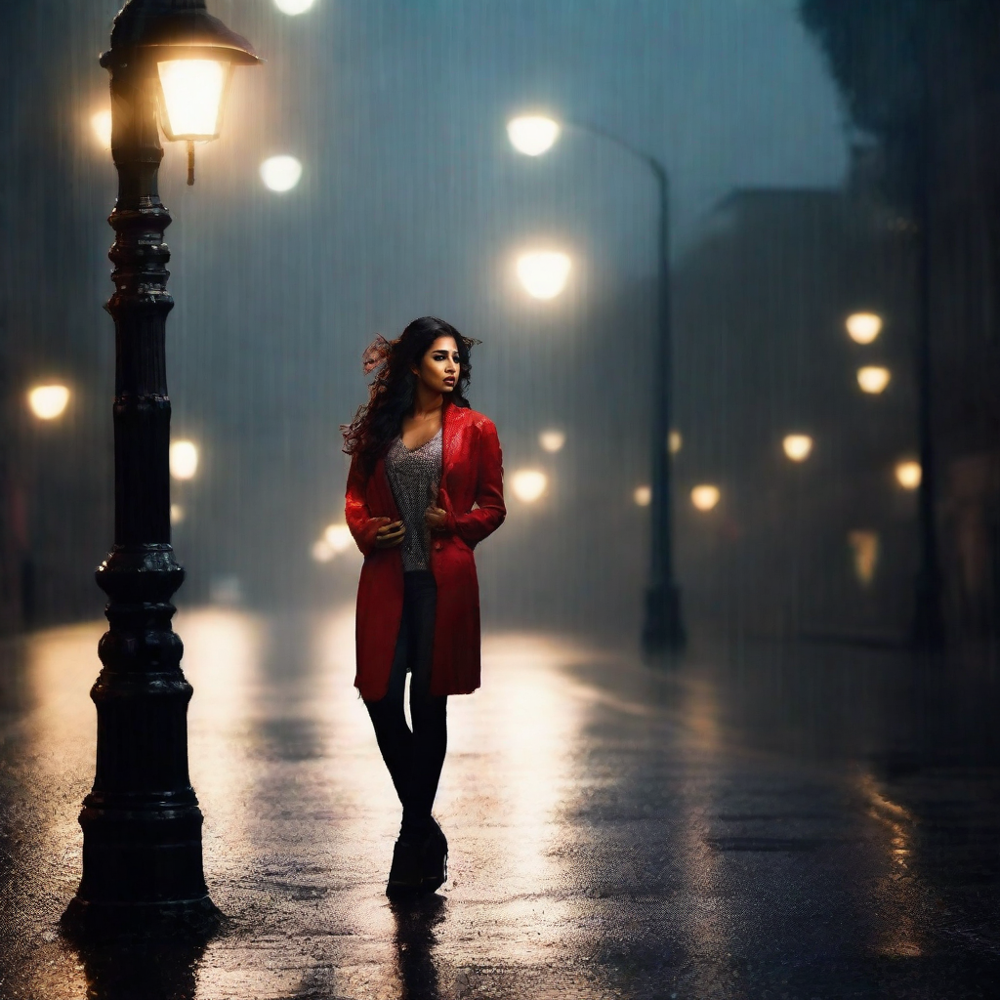

In [17]:
images[0]

In [19]:
prompt = "a close up photography of an Indian Fashon Model standing under a lamp post in a street with rain falling in the background"

In [20]:
images = []
for steps in range(8):
  generator = torch.Generator(device=pipe.device).manual_seed(1337)
  image = pipe(prompt=prompt,
              num_inference_steps = steps + 1,
              guidance_scale = 1,
              generator=generator,).images[0]
  images.append(image)


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

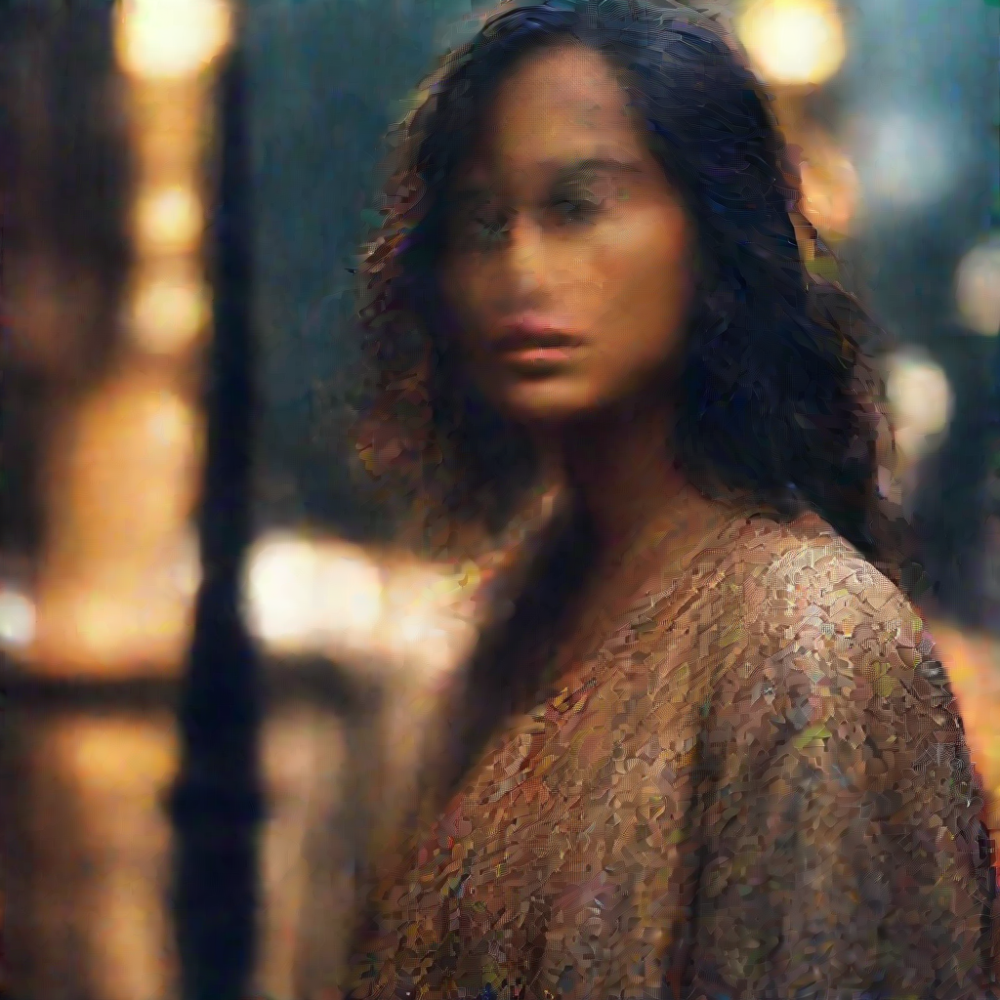

In [21]:
images[0]

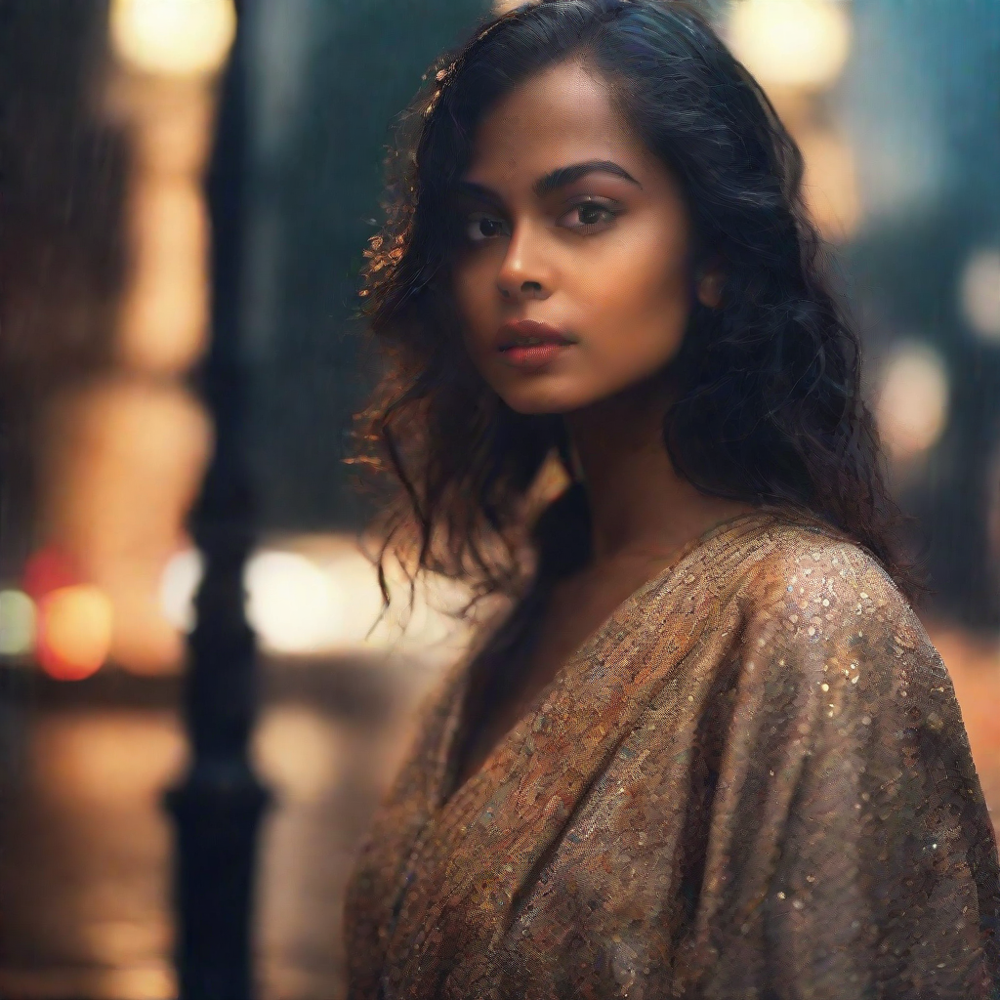

In [22]:
images[1]

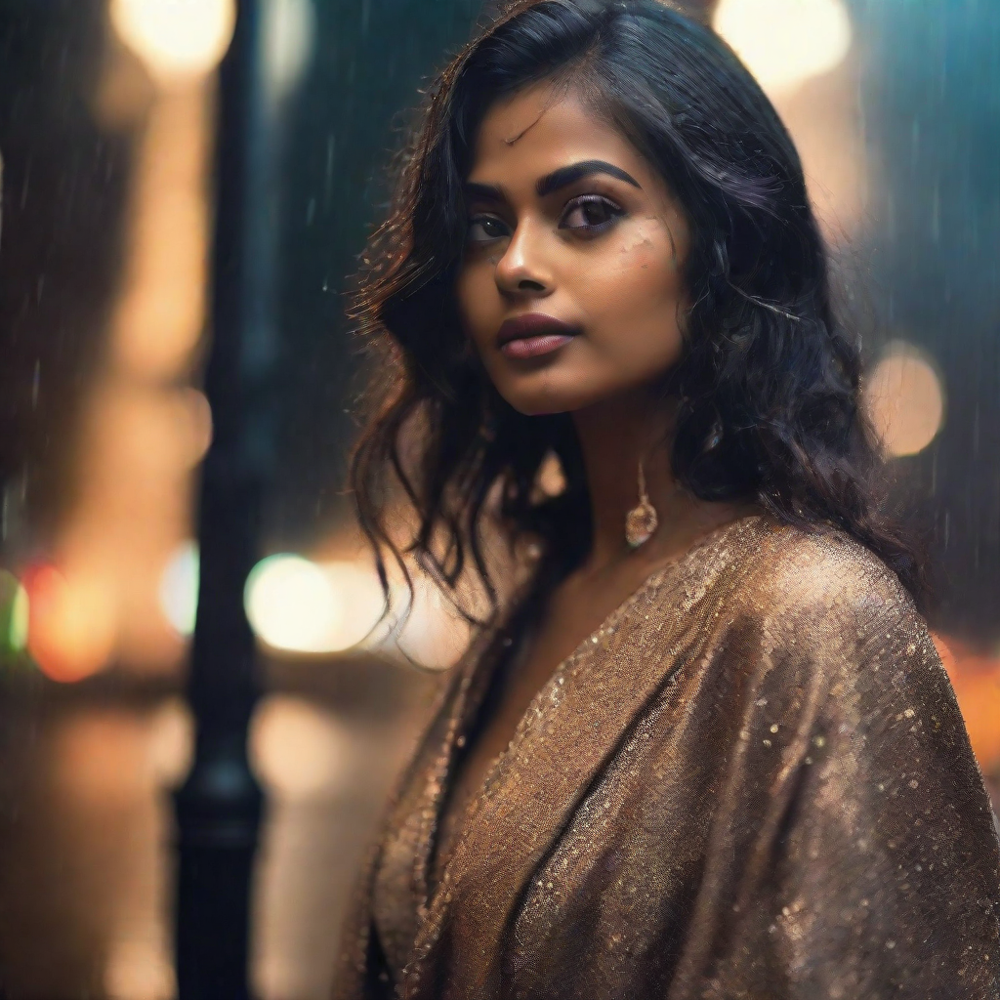

In [23]:
images[2]

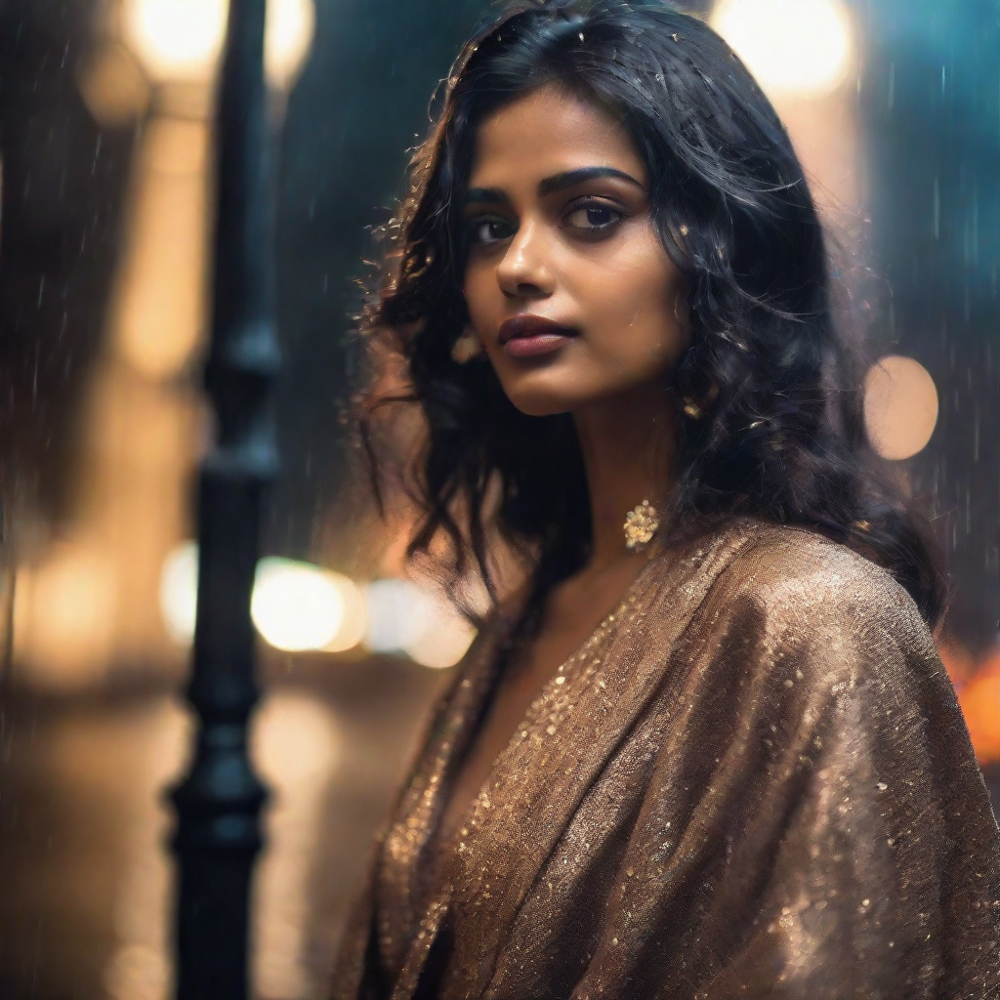

In [24]:
images[3]

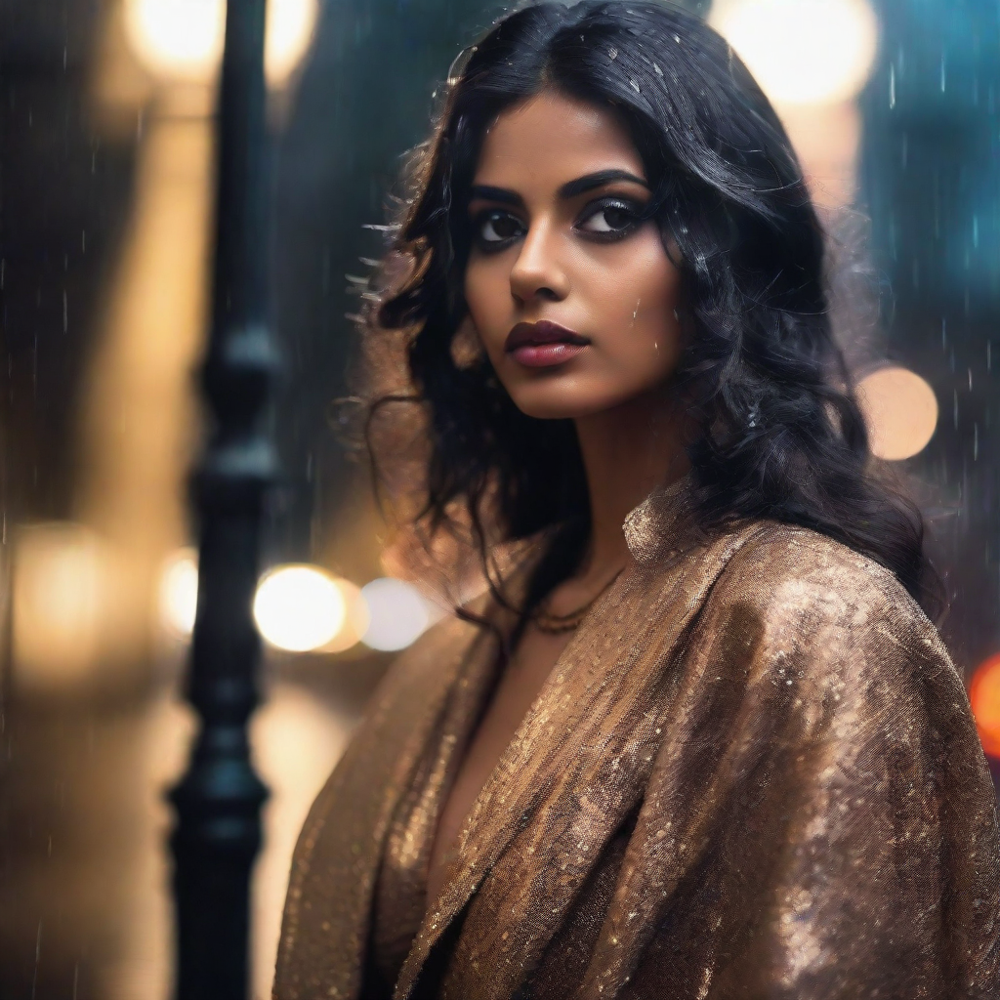

In [25]:
images[4]

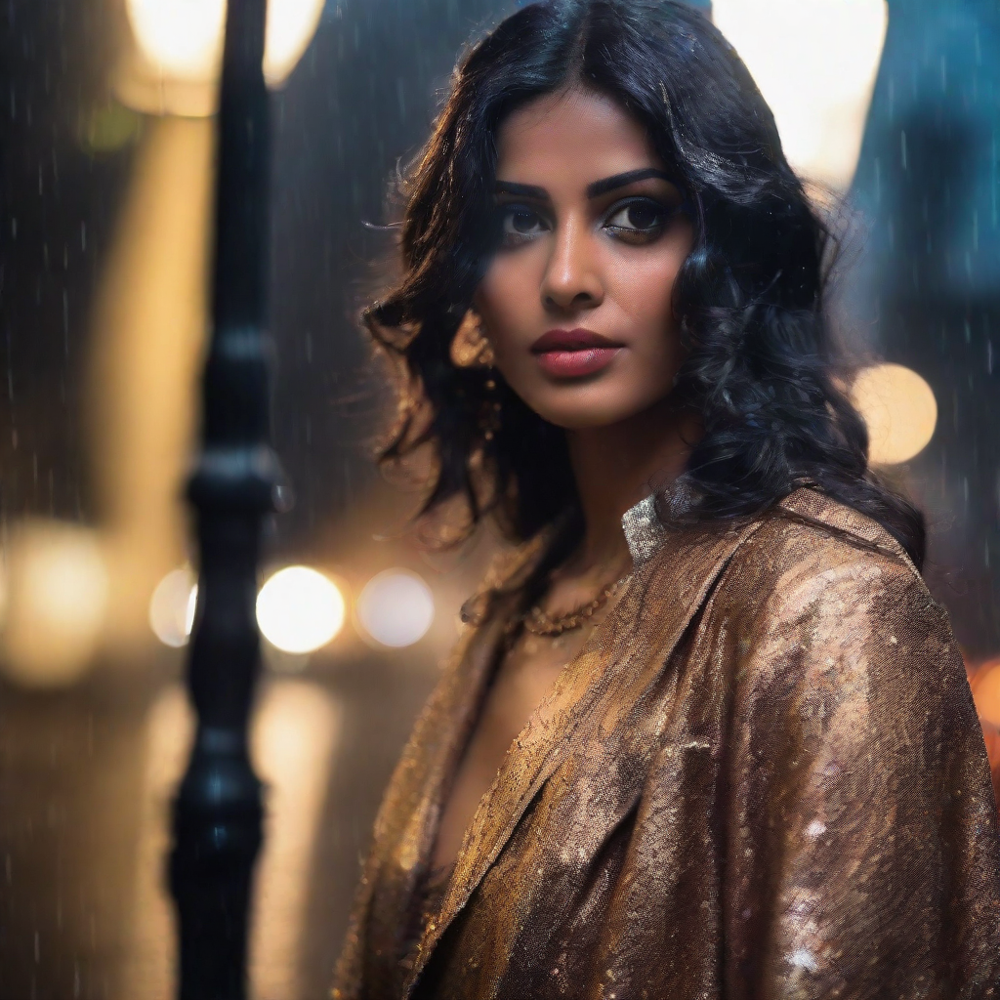

In [26]:
images[5]

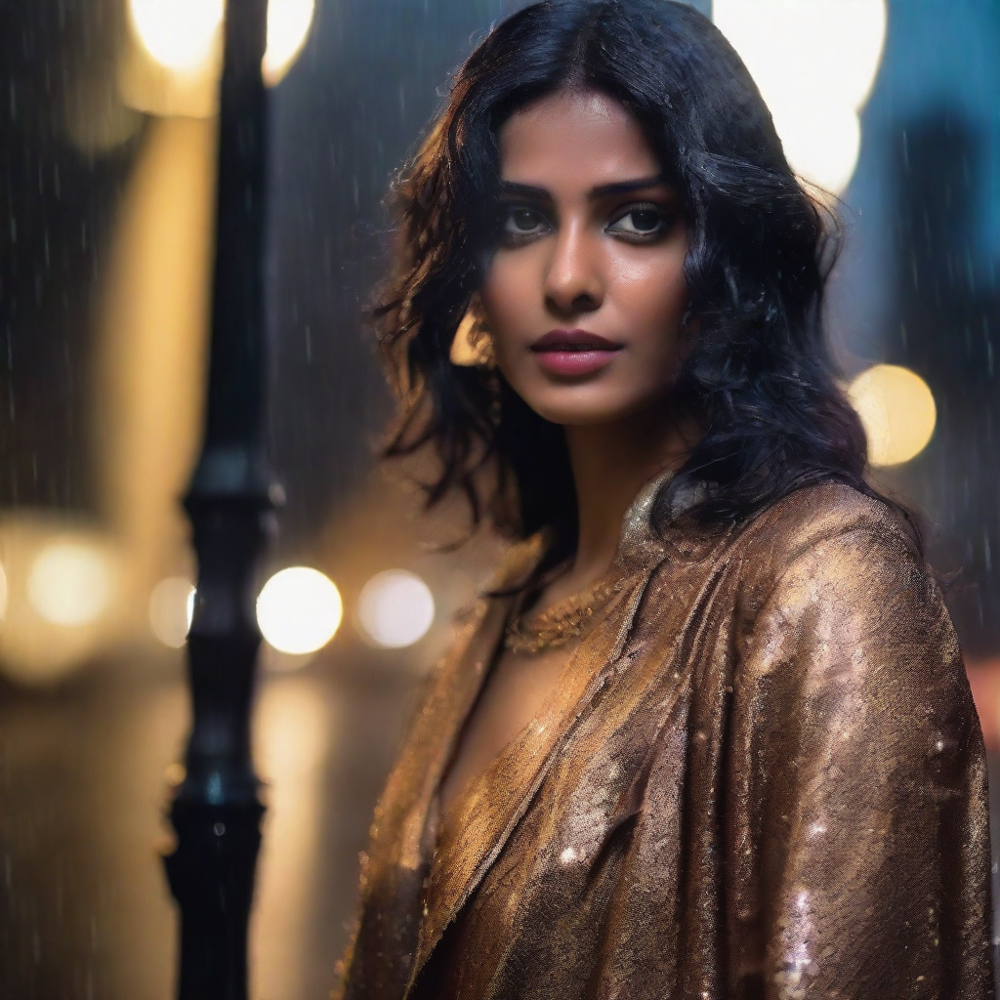

In [27]:
images[6]

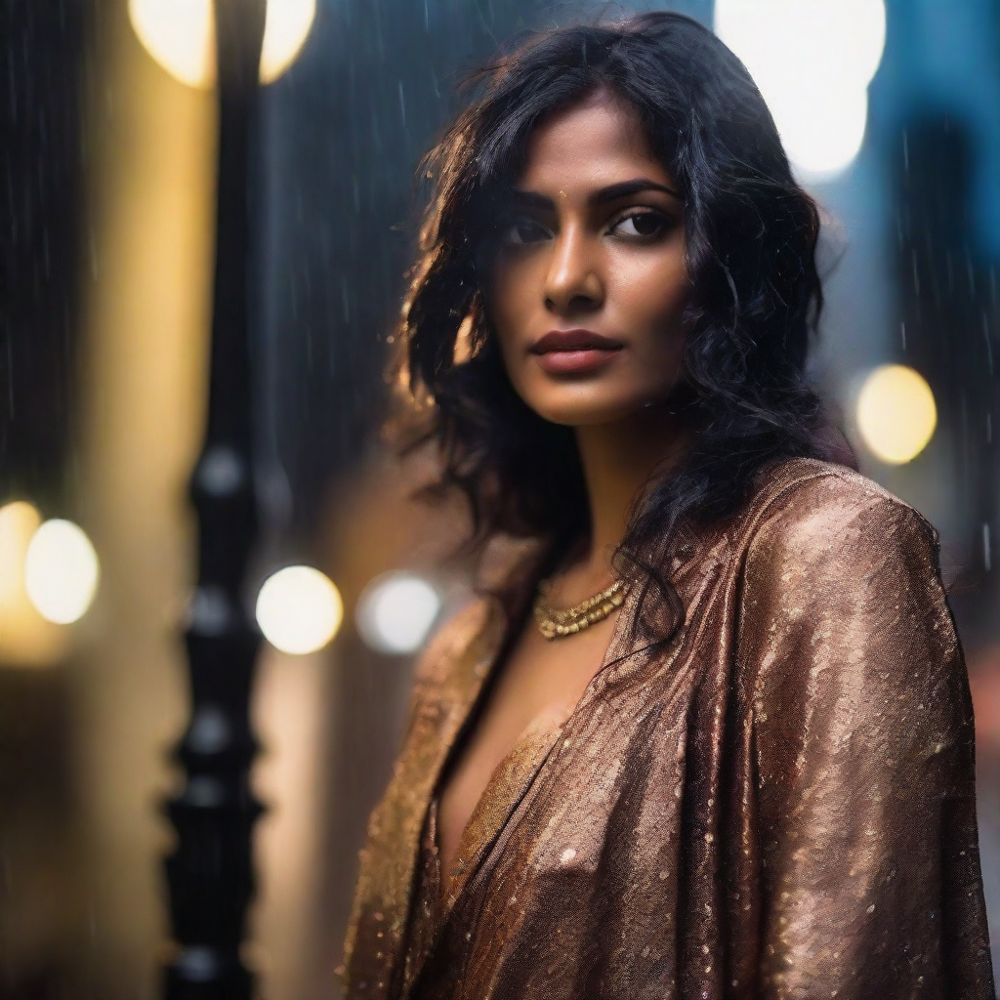

In [28]:
images[7]

####Notes:
* guidance_scale valu is between 0 to 2, 0 to 1 = negative prompts ignored, 1 to 2 we can use negative prompt and image generation will be smaller
*


In [59]:
#prompt = "a clear distant natural looking photo of an Indian actress wearing a vibrant red plain saree and wind blowing the saree and her hair with snow falling in the background"
prompt = "a photorealistic fashion photography of an Indian Fashon Model standing under a lamp post in a street with rain falling in the background"
images = []
for steps in range(8):
  generator = torch.Generator(device=pipe.device).manual_seed(1337)
  image = pipe(prompt=prompt,
              num_inference_steps = steps + 1,
              guidance_scale = 1,
              generator=generator,).images[0]
  images.append(image)


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

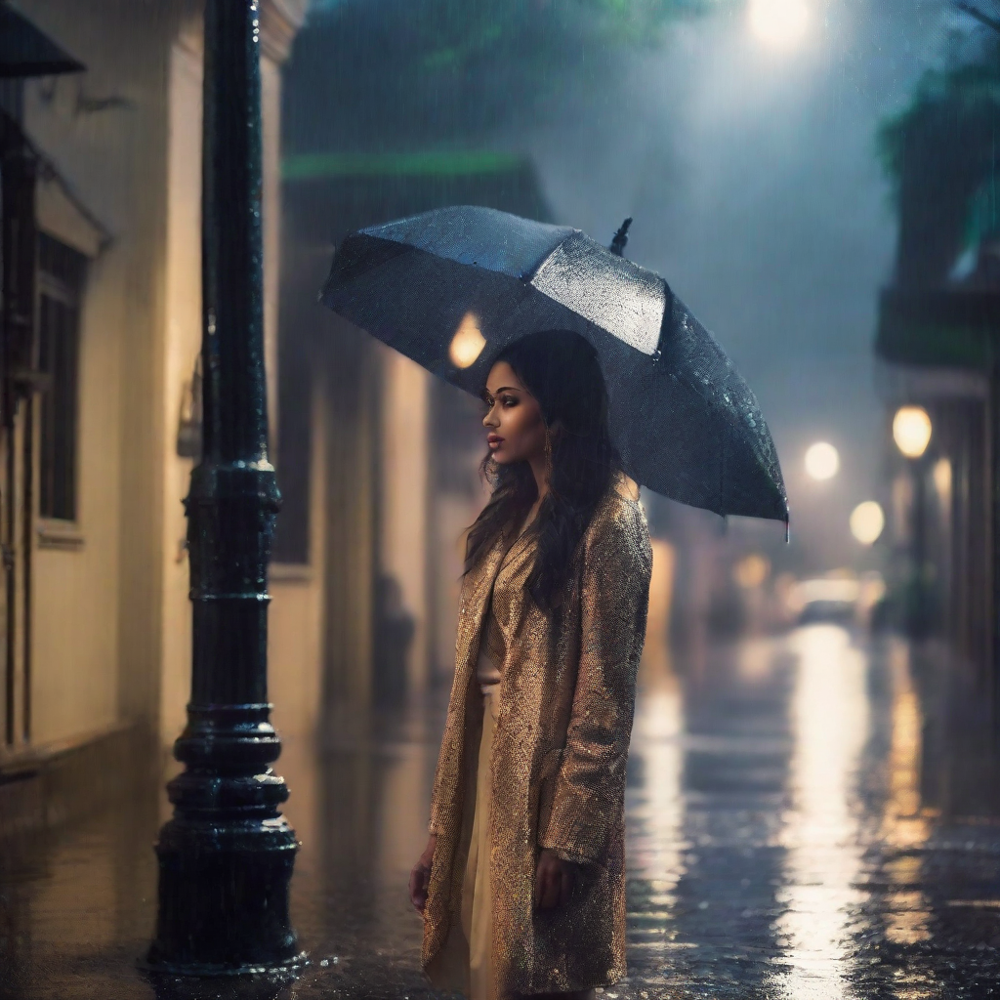

In [60]:
images[5]

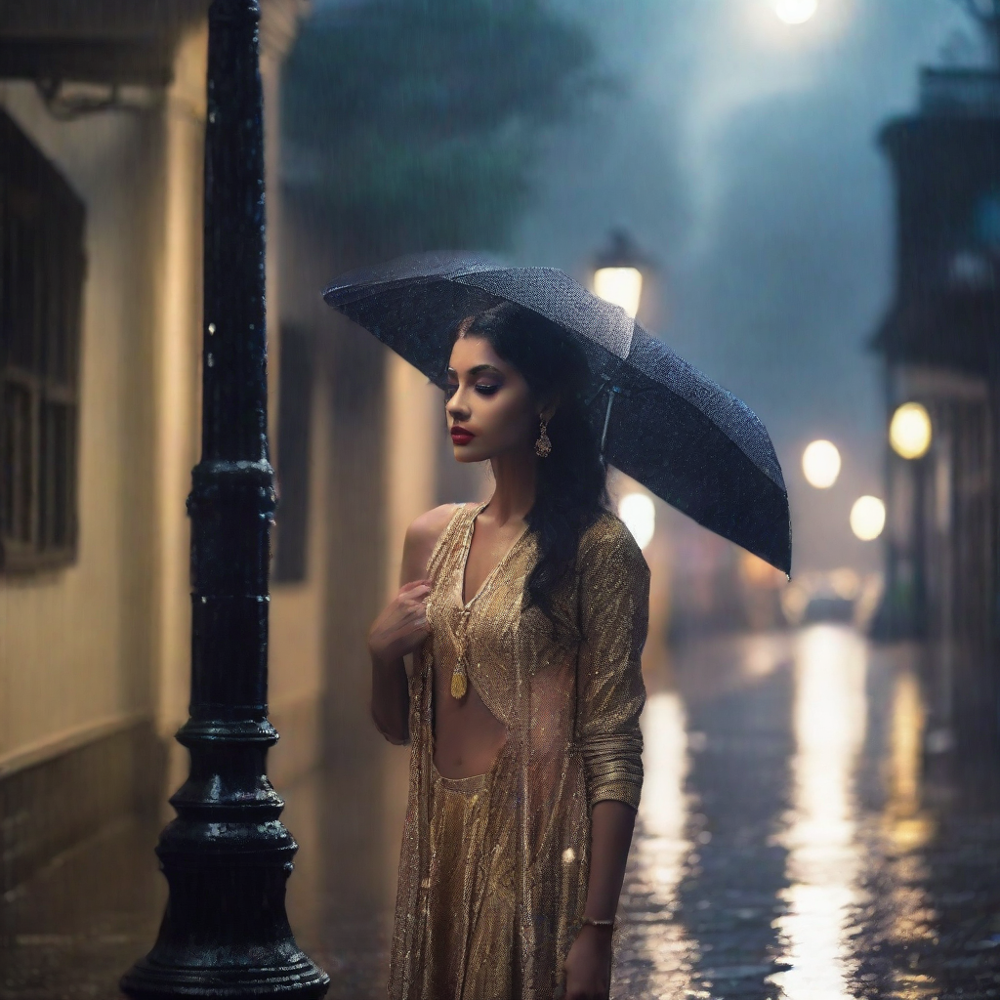

In [61]:
images[6]

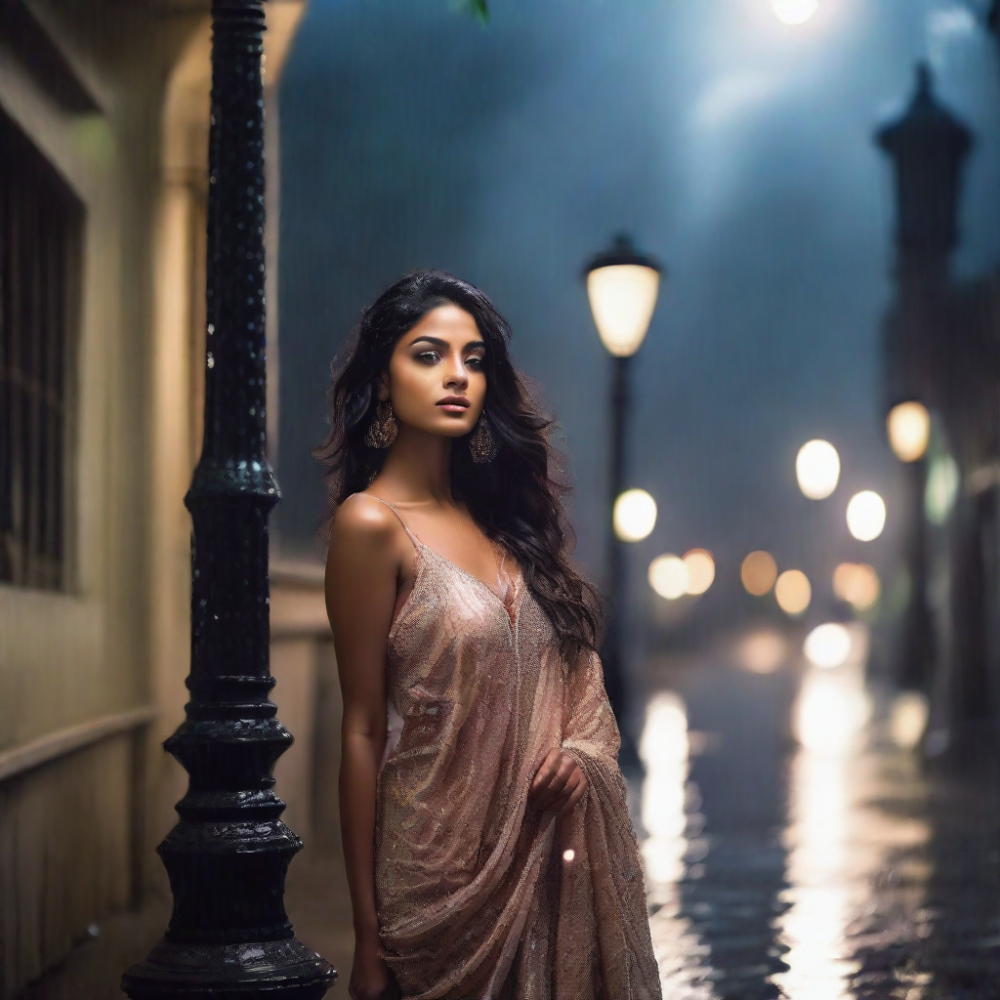

In [62]:
images[7]

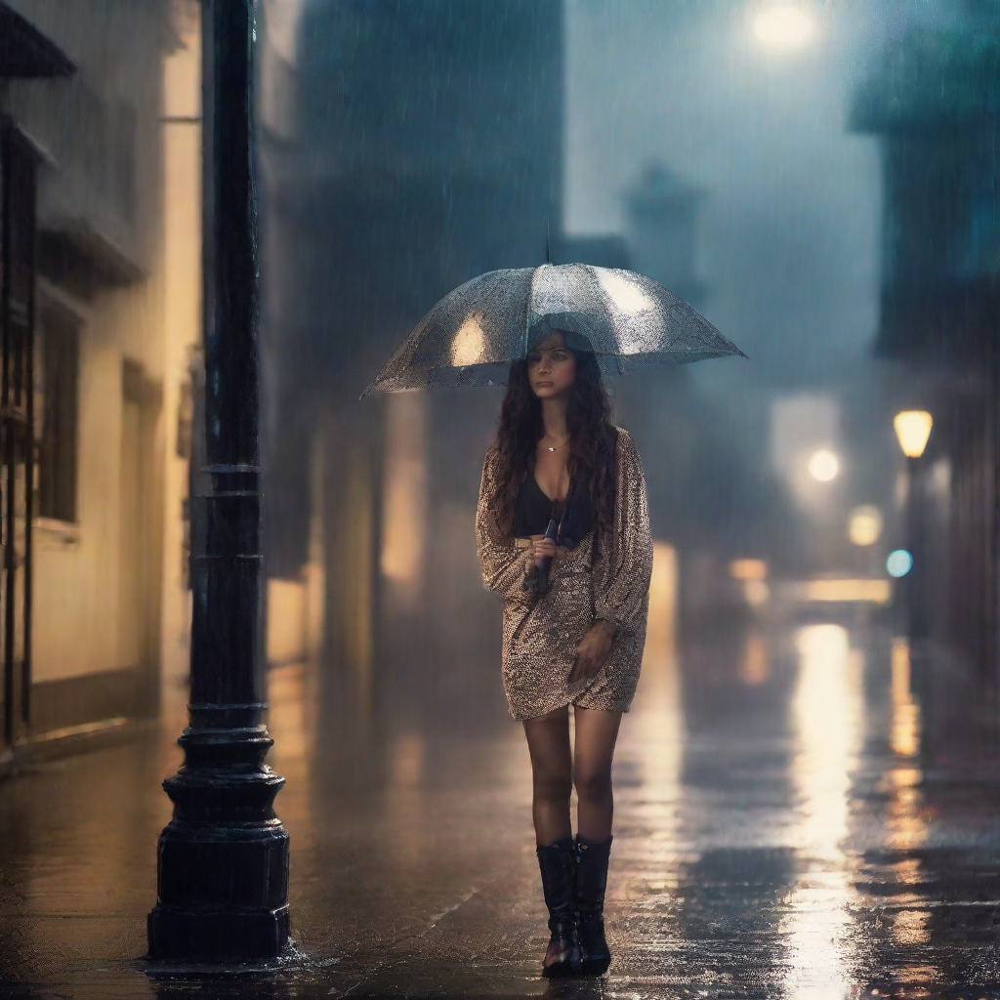

In [64]:
images[4]

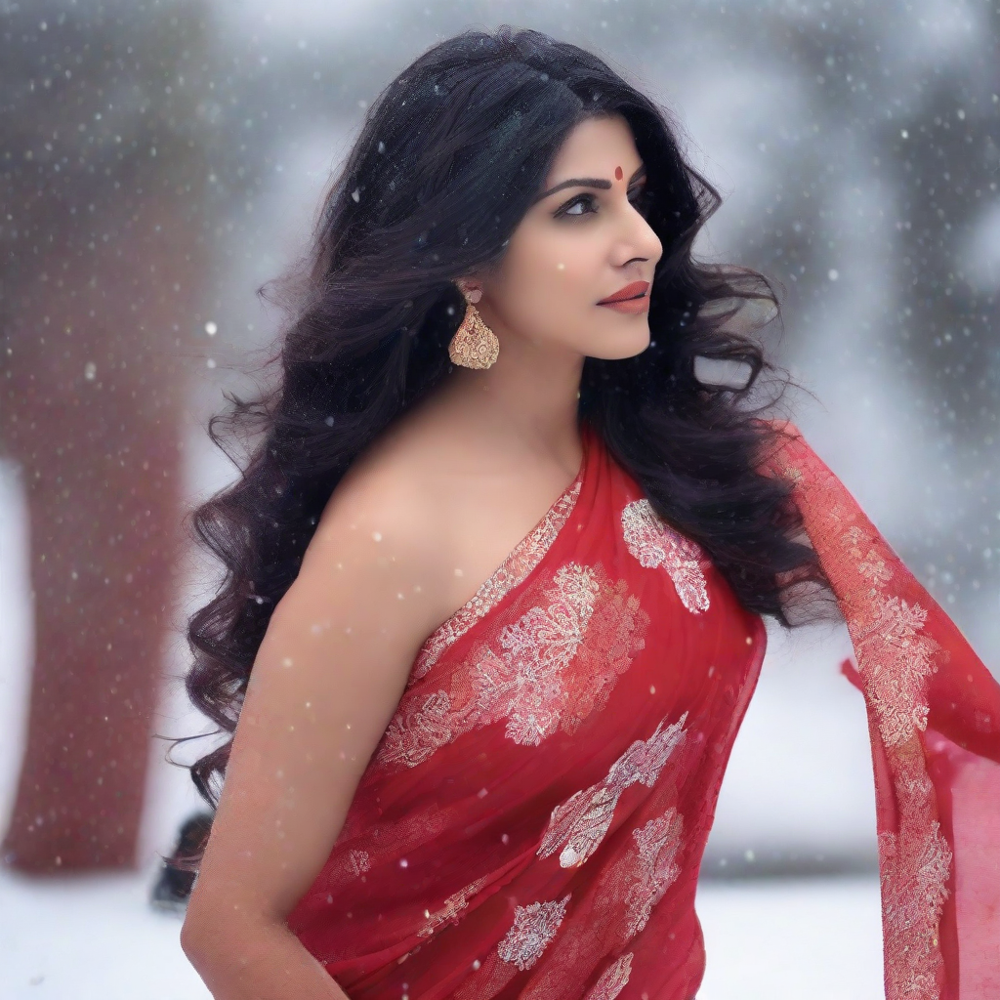

In [36]:
images[6]

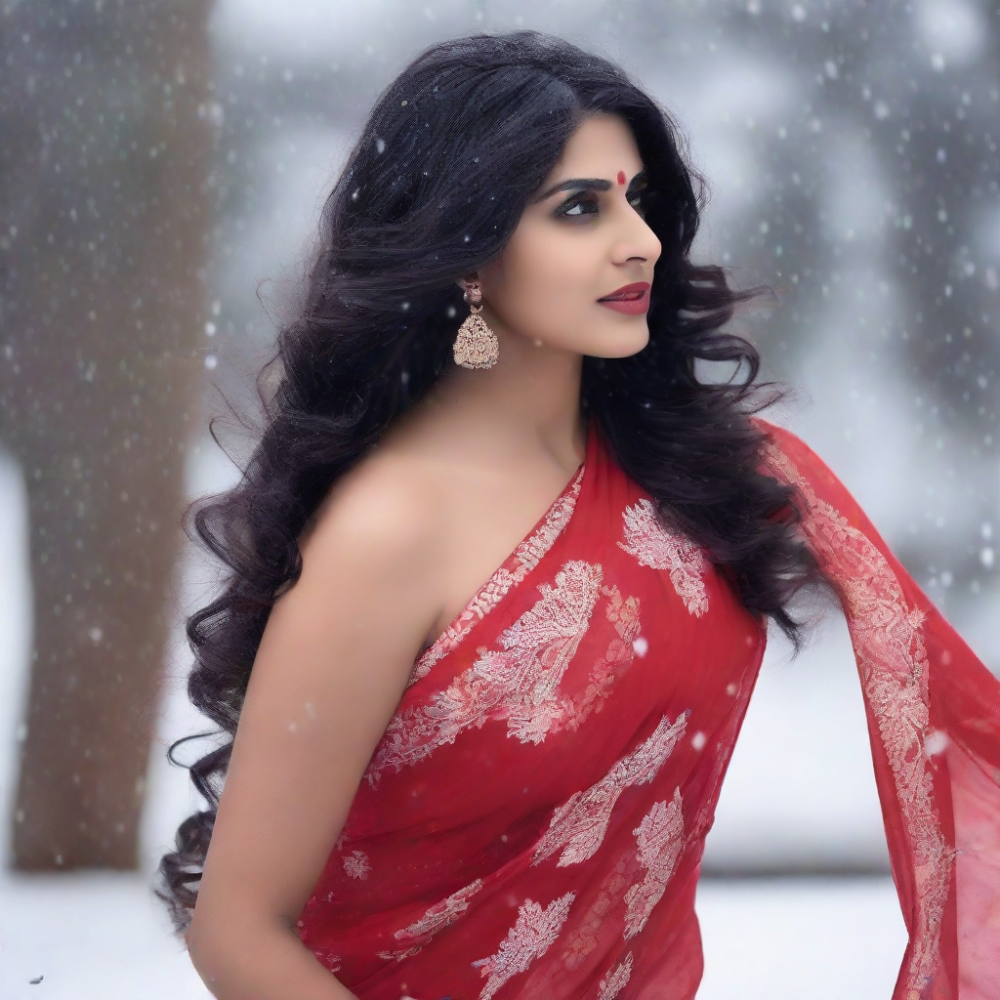

In [37]:
images[7]

## Comapre Image Generation to Normal Image generation steps using EulerDiscreteScheduler

In [38]:
pipe.unload_lora_weights()

You are using `unload_lora_weights` to disable and unload lora weights. If you want to iteratively enable and disable adapter weights,you can use `pipe.enable_lora()` or `pipe.disable_lora()`. After installing the latest version of PEFT.
/usr/local/lib/python3.10/dist-packages/diffusers/loaders.py:1876: FutureWarning: `_remove_text_encoder_monkey_patch_classmethod` is deprecated and will be removed in version 0.25. You are using an old version of LoRA backend. This will be deprecated in the next releases in favor of PEFT make sure to install the latest PEFT and transformers packages in the future.
  deprecate("_remove_text_encoder_monkey_patch_classmethod", "0.25", LORA_DEPRECATION_MESSAGE)


In [39]:
from diffusers import EulerDiscreteScheduler
pipe.scheduler = EulerDiscreteScheduler.from_config(pipe.scheduler.config)

In [47]:
prompt = "a photorealistic fashion photography of an Indian Fashon Model standing under a lamp post in a street with rain falling in the background"
images = []
for steps in [1,4,8,15,25,30,50,100]:
  generator = torch.Generator(device=pipe.device).manual_seed(1337)
  image = pipe(prompt=prompt,
              num_inference_steps = steps,
              generator=generator,).images[0]
  images.append(image)

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

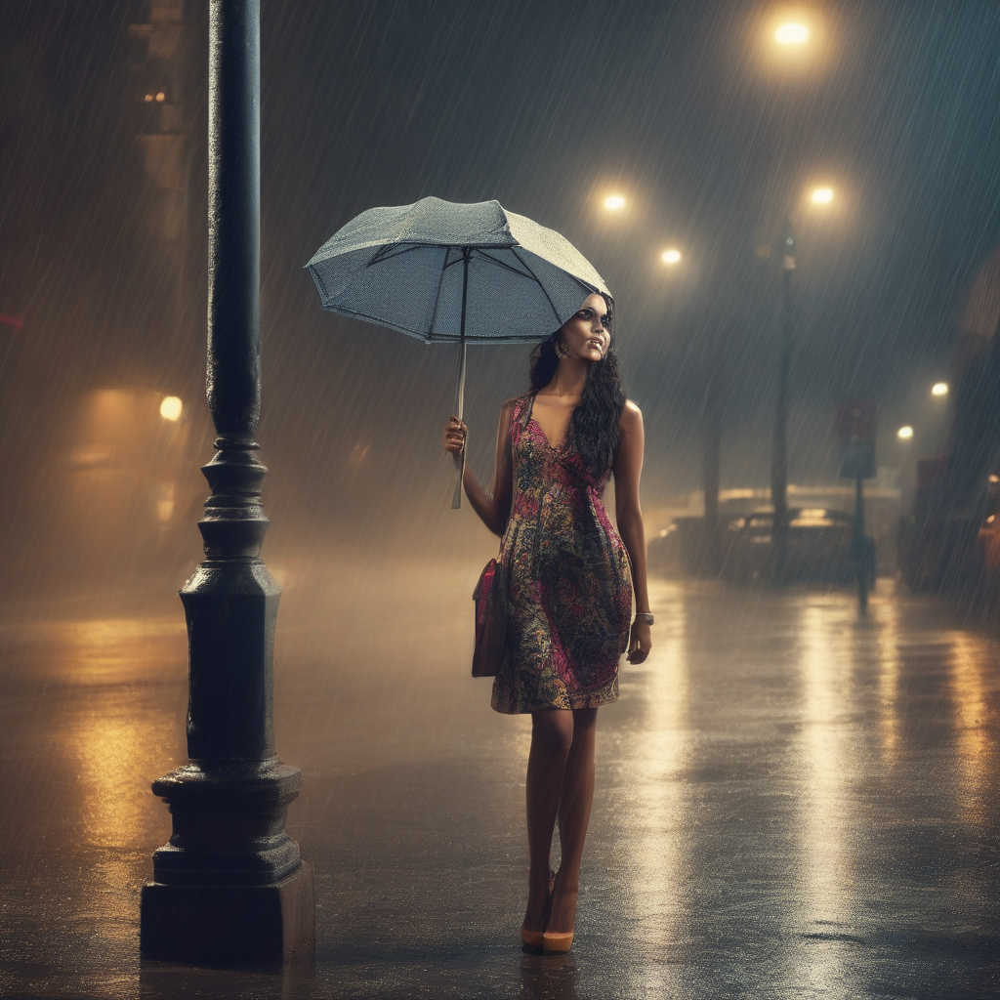

In [48]:
images[5]

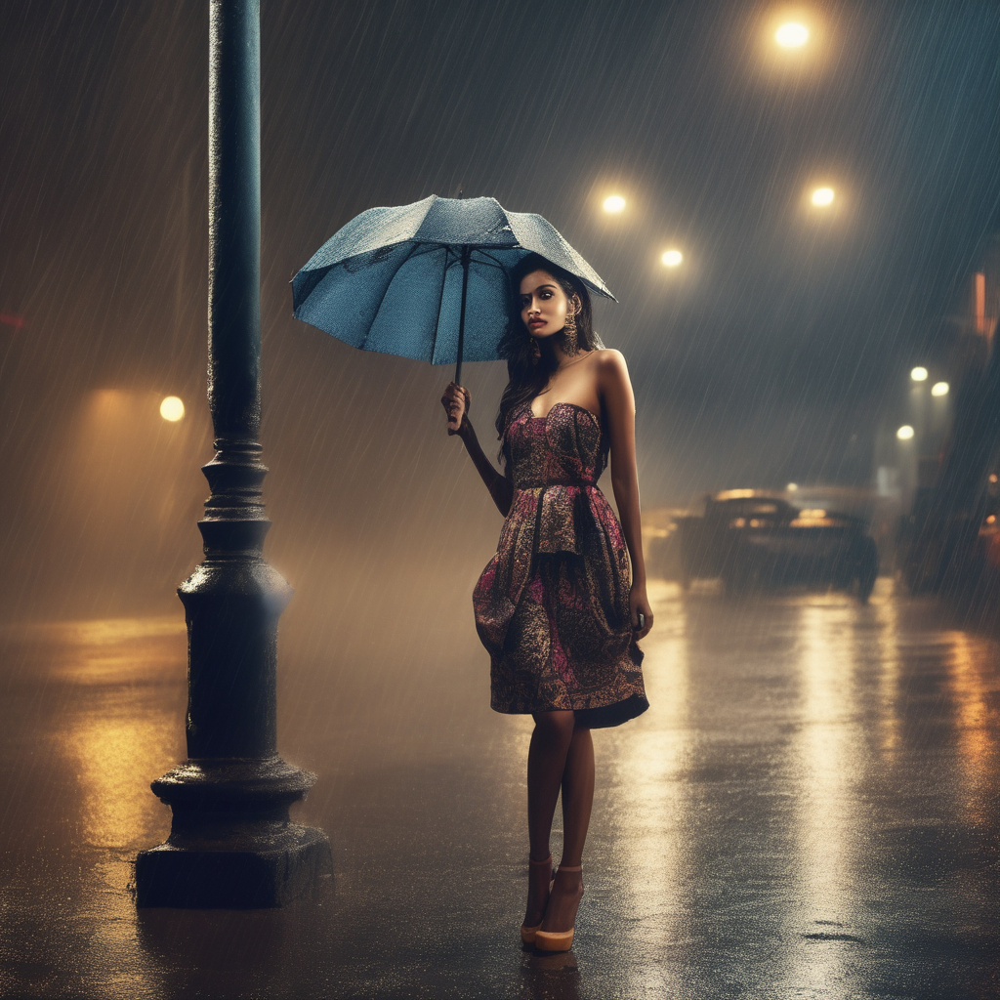

In [49]:
images[6]

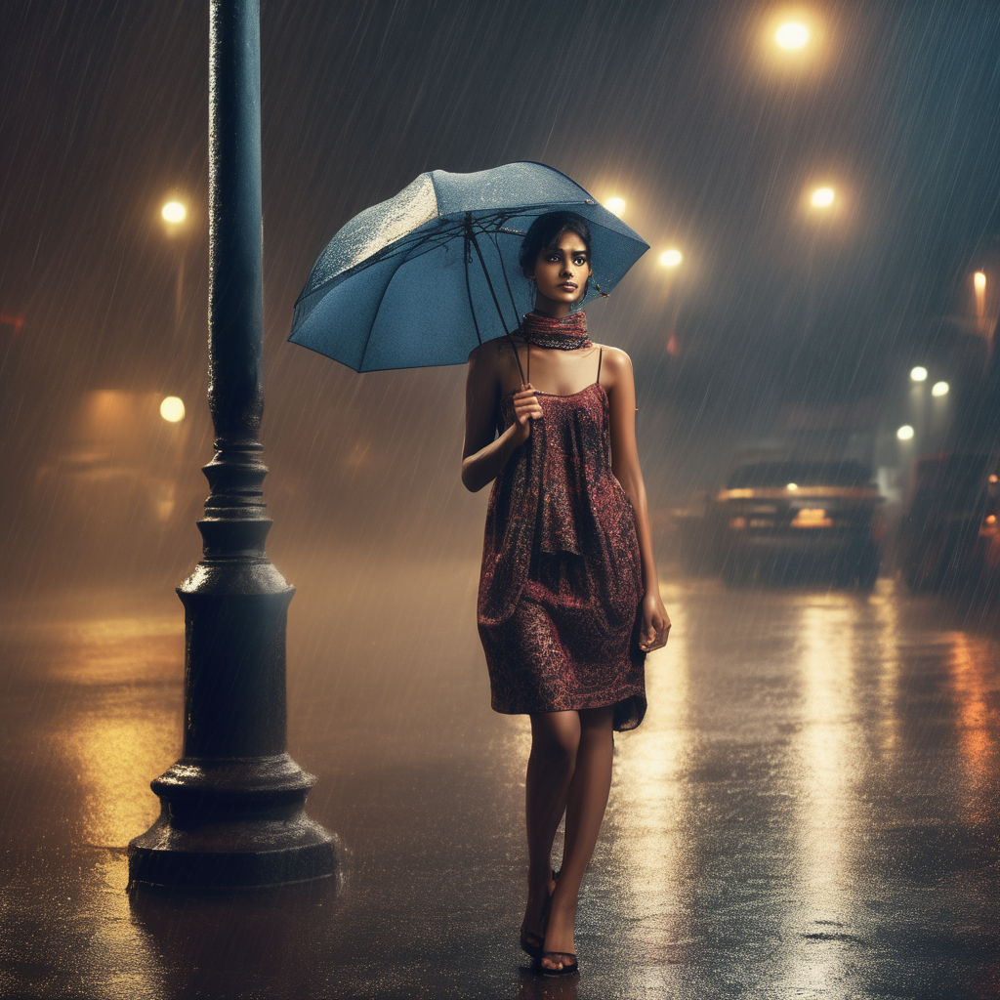

In [50]:
images[7]

## Exploring Segminds Stable Diffusion model -60% Faster

## Import Required Dependencies

In [65]:
%%capture
! pip install git+https://github.com/huggingface/diffusers
! pip install transformers accelerate safetensors

In [66]:
from diffusers import StableDiffusionXLPipeline
pipe = StableDiffusionXLPipeline.from_pretrained("segmind/SSD-1B",
                                               torch_dtype=torch.float16,
                                              use_safetensors = True,
                                               variants="fp16")
pipe.to("cuda")

model_index.json:   0%|          | 0.00/577 [00:00<?, ?B/s]

Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

text_encoder/config.json:   0%|          | 0.00/560 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/474 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.77k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

tokenizer_2/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/602 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.33G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Keyword arguments {'variants': 'fp16'} are not expected by StableDiffusionXLPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

StableDiffusionXLPipeline {
  "_class_name": "StableDiffusionXLPipeline",
  "_diffusers_version": "0.23.1",
  "_name_or_path": "segmind/SSD-1B",
  "force_zeros_for_empty_prompt": true,
  "scheduler": [
    "diffusers",
    "EulerDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 5.96 µs


  0%|          | 0/50 [00:00<?, ?it/s]

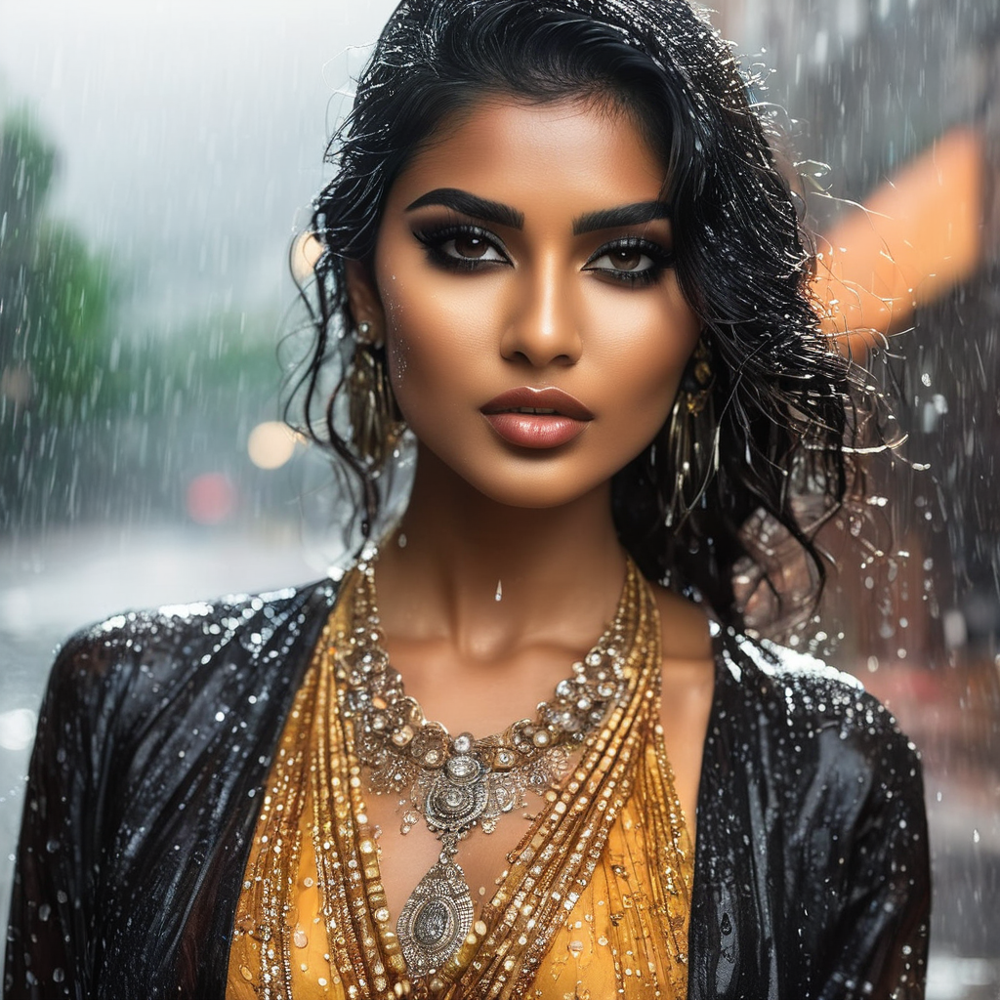

In [71]:
%time
from transformers.pipelines.image_to_text import Image
from IPython.display import display

prompt = "a close up photograph of Indian Fashon Model posing in a street with rain falling in the background."
neg_prompt = "ugly,blurry,poor quality,deformed hands,deformed face,deformed legs,deformed eyes, deformed nose"
image = pipe(prompt=prompt,
             negative_prompt=neg_prompt).images[0]
display(image)